In [1]:
import pandas as pd 
import seaborn as sns
import numpy as np 
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import plotly.express as px

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 200)
pd.set_option('display.width', 10000)
pd.set_option('display.max_colwidth', None)

# Loading file
Data from file ***"LAEI2013_Emissions_Summary-CO2_v1.1.xlsx"*** and sheet ***"CO2 by Grid Exact Cut"*** is loaded. 


In [2]:
df = pd.read_excel("LAEI2013_Emissions_Summary-CO2_v1.1.xlsx",skiprows=3,sheet_name="CO2 by Grid Exact Cut")
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20130 entries, 0 to 20129
Data columns (total 41 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Year                              20130 non-null  int64  
 1   LAEI 1km2 ID                      20130 non-null  int64  
 2   GRID_ExactCut_ID                  20130 non-null  int64  
 3   Easting                           20130 non-null  int64  
 4   Northing                          20130 non-null  int64  
 5   Borough                           20130 non-null  object 
 6   Zone                              20130 non-null  object 
 7   Household and Garden              20130 non-null  int64  
 8   Small Waste and Accidental Fires  20130 non-null  int64  
 9   Agriculture                       20130 non-null  int64  
 10  STW                               20130 non-null  object 
 11  WTS                               20130 non-null  int64  
 12  Land

In [3]:
df.head()

,Year,LAEI 1km2 ID,GRID_ExactCut_ID,Easting,Northing,Borough,Zone,Household and Garden,Small Waste and Accidental Fires,Agriculture,STW,WTS,Landfill,NRMM Construction,NRMM Industry,C&D Dust,Domestic Gas,Commercial Gas,Domestic Other Fuels,Commercial Other Fuels,Industry Part A,Industry Part B,Aviation,Passenger Shipping,Commercial Shipping,Rail Freight,Rail Passengers,Resuspension,Motorcycle,Taxi,Petrol Car,Diesel Car,Electric Car,Petrol LGV,Diesel LGV,Electric LGV,TfL Bus,Non-TfL Bus and Coach,Artic HGV,Rigid HGV,Total
0,2008,5910,1,510500,203500,NonGLA,NonGLA,0,0,0,0,0,40.299208,0.0,29.037647,0,169.896525,267.599694,34.661398,225.726463,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.794446,0.729308,65.296798,28.201613,0,0.530240,11.047829,0,0.976673,3.437355,1.056543,6.777960,886.069700
1,2008,5911,2,511500,203500,NonGLA,NonGLA,0,0,0,0,0,0.000000,0.0,16.445759,0,91.442445,311.594175,20.145096,276.459214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,46.059539,75.319727,4813.802423,2779.411657,0,82.955116,1515.757059,0,30.338328,193.357560,2591.992620,1153.954988,13999.035705
2,2008,5912,3,512500,203500,NonGLA,NonGLA,0,0,0,0,0,0.000000,0.0,77.735009,0,253.379851,311.591604,19.937190,276.456934,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,19.434101,34.094676,2188.666090,1398.219593,0,44.999390,721.108900,0,5.993533,79.087914,1899.210830,620.269635,7950.185250
3,2008,5915,4,515500,203500,NonGLA,NonGLA,0,0,0,0,0,10152.007346,0.0,19.704125,0,980.361642,320.748184,6.243711,276.459214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.792363,0.727326,65.081353,28.108563,0,0.528477,11.011090,0,0.973637,3.426670,1.049198,6.755514,11873.978414
4,2008,5916,5,516500,203500,NonGLA,NonGLA,0,0,0,0,0,3513.850389,0.0,1.028658,0,1122.054950,505.360236,9.088597,276.456934,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.714850,0.656304,58.761915,25.379204,0,0.477185,9.942397,0,0.878163,3.090653,0.948943,6.099634,5534.789011


In [4]:
df.describe()

,Year,LAEI 1km2 ID,GRID_ExactCut_ID,Easting,Northing,Household and Garden,Small Waste and Accidental Fires,Agriculture,WTS,Landfill,NRMM Construction,NRMM Industry,C&D Dust,Domestic Gas,Commercial Gas,Domestic Other Fuels,Commercial Other Fuels,Industry Part A,Industry Part B,Aviation,Passenger Shipping,Commercial Shipping,Rail Freight,Rail Passengers,Resuspension,Motorcycle,Taxi,Petrol Car,Diesel Car,Electric Car,Petrol LGV,Diesel LGV,Electric LGV,TfL Bus,Non-TfL Bus and Coach,Artic HGV,Rigid HGV,Total
count,20130.000000,20130.000000,20130.000000,20130.000000,20130.000000,20130.0,20130.0,20130.0,20130.0,20130.000000,20130.000000,20130.000000,20130.0,20130.000000,20130.000000,20130.000000,20130.000000,2.013000e+04,20130.000000,20130.000000,20130.000000,20130.000000,20130.000000,20130.000000,20130.0,20130.000000,20130.000000,20130.000000,20130.000000,20130.0,20130.000000,20130.000000,20130.0,20130.000000,20130.000000,20130.000000,20130.000000,2.013000e+04
mean,2017.666667,10171.481073,1678.000000,529707.451565,178835.618480,0.0,0.0,0.0,0.0,427.420819,117.496823,19.570348,0.0,2783.727441,990.360304,32.005776,146.316986,9.176346e+02,11.127363,309.755089,4.214663,15.537181,8.819486,16.211693,0.0,26.493076,67.337890,1005.886123,648.730007,0.0,9.135018,332.509128,0.0,191.187940,74.759430,242.730629,251.391879,8.656917e+03
std,8.014076,2159.581806,968.529091,14687.054077,12554.600433,0.0,0.0,0.0,0.0,1836.299258,558.355922,59.854113,0.0,3316.014933,2606.451888,47.880695,215.864217,2.752508e+04,245.808239,4189.167950,52.379721,293.145694,32.433366,80.599408,0.0,43.462504,201.678891,1129.664211,800.946544,0.0,14.202476,443.371121,0.0,371.550456,129.322997,710.328592,338.621171,2.897317e+04
min,2008.000000,5910.000000,1.000000,501500.000000,152500.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,4.427951e-02
25%,2010.000000,8487.000000,839.000000,517500.000000,169500.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.364007,0.0,183.500813,108.152791,3.842142,27.215686,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,2.523172,2.374505,139.546092,83.614340,0.0,0.811943,33.783221,0.0,0.796812,4.712309,4.813026,23.711071,1.580159e+03
50%,2016.500000,10059.000000,1678.000000,529500.000000,179500.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,3.025724,0.0,1451.472097,323.357194,16.857167,70.115763,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,12.363473,13.767393,665.779156,401.138525,0.0,4.046493,173.633100,0.0,39.540587,31.741417,32.449651,123.541299,5.757474e+03
75%,2025.000000,11797.000000,2517.000000,541500.000000,188500.000000,0.0,0.0,0.0,0.0,0.000000,53.816327,14.648292,0.0,4564.214706,857.449041,39.572522,165.798991,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,32.300334,46.604869,1471.189786,875.041137,0.0,11.048864,418.994010,0.0,221.331858,93.900687,108.312558,317.201549,1.144757e+04
max,2030.000000,14708.000000,3355.000000,561500.000000,203500.000000,0.0,0.0,0.0,0.0,31761.487299,23051.797402,1768.834170,0.0,51333.187056,71356.147049,776.079192,1748.750255,2.300000e+06,14769.330000,136471.072451,1864.350969,13926.405276,369.468909,1083.979343,0.0,686.214041,4022.979519,9178.180132,6249.957837,0.0,136.721473,3020.166870,0.0,5238.205652,2064.881628,6721.669060,2797.157956,2.312328e+06


In [ ]:
# Data frame has 20130 entries with a total of 41 columns
# All 20130 entries appears to be non null. 
# Columns "Borough","Zone" and "STW" have datatype object, the values must be encoded. 
# Column "STW" contains numerical values formatted as strings, pd.to_numeric() might be usefull. 
# Columns with zero weight are present. 

In [5]:
#change STW column to numeric values
df.STW = pd.to_numeric(df.STW,errors='coerce')


In [6]:
df.STW.isna().sum()

1

In [7]:
df.loc[df.STW.isna()]

,Year,LAEI 1km2 ID,GRID_ExactCut_ID,Easting,Northing,Borough,Zone,Household and Garden,Small Waste and Accidental Fires,Agriculture,STW,WTS,Landfill,NRMM Construction,NRMM Industry,C&D Dust,Domestic Gas,Commercial Gas,Domestic Other Fuels,Commercial Other Fuels,Industry Part A,Industry Part B,Aviation,Passenger Shipping,Commercial Shipping,Rail Freight,Rail Passengers,Resuspension,Motorcycle,Taxi,Petrol Car,Diesel Car,Electric Car,Petrol LGV,Diesel LGV,Electric LGV,TfL Bus,Non-TfL Bus and Coach,Artic HGV,Rigid HGV,Total
10064,2013,9716,3355,532500,181500,City,Central,0,0,0,NaN,0,0.0,122.848184,134.502843,0,964.058018,42848.672915,33.703328,1054.208441,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,317.391173,2629.033349,2483.951375,1244.671718,0,27.658061,1235.396217,0,3724.741417,777.945882,283.688576,1159.568824,59042.040319


In [ ]:
# After converting a columns values it is preferable to check if there are values that has become null. 
# in this case we found only row, and it falls also under the target year that we want to consider in this assignement. 
# being it only one row it is safe to remove it (even we have not yet dropped the years we do not want to have in dataset)

In [8]:
df.STW = df.STW.fillna(0)
df.STW.isna().sum()


0

## Encoding the values with label encoder 

In [3]:
# we can encode the data in the columns where we have strings
# LabelEncoder from SKleanr module  will be used, OneHot encoding will be avoided to reduce the data complexity. 
# mapping for the encoded values will be created, in order to be able to interpret the values after. 

In [11]:
encoding_data = df.copy()

In [12]:
l_encoder = LabelEncoder()
l_encoder.fit(encoding_data['Zone'])
encoding_data['Zone'] = l_encoder.fit_transform(encoding_data['Zone'])
mapping_zone = dict(zip(l_encoder.classes_, range(len(l_encoder.classes_))))
mapping_zone

{'Central': 0, 'Inner': 1, 'NonGLA': 2, 'Outer': 3}

In [13]:
l_encoder.fit(encoding_data['Borough'])
encoding_data['Borough'] = l_encoder.fit_transform(encoding_data['Borough'])
mapping_borough = dict(zip(l_encoder.classes_, range(len(l_encoder.classes_))))
mapping_borough

{'Barking and Dagenham': 0,
 'Barnet': 1,
 'Bexley': 2,
 'Brent': 3,
 'Bromley': 4,
 'Camden': 5,
 'City': 6,
 'City of Westminster': 7,
 'Croydon': 8,
 'Ealing': 9,
 'Enfield': 10,
 'Greenwich': 11,
 'Hackney': 12,
 'Hammersmith and Fulham': 13,
 'Haringey': 14,
 'Harrow': 15,
 'Havering': 16,
 'Hillingdon': 17,
 'Hounslow': 18,
 'Islington': 19,
 'Kensington and Chelsea': 20,
 'Kingston': 21,
 'Lambeth': 22,
 'Lewisham': 23,
 'Merton': 24,
 'Newham': 25,
 'NonGLA': 26,
 'Redbridge': 27,
 'Richmond': 28,
 'Southwark': 29,
 'Sutton': 30,
 'Tower Hamlets': 31,
 'Waltham Forest': 32,
 'Wandsworth': 33}

# Year column analysis


In [9]:
df.Year.unique()

array([2008, 2010, 2013, 2020, 2025, 2030])

In [10]:
df.columns

Index(['Year', 'LAEI 1km2 ID', 'GRID_ExactCut_ID', 'Easting', 'Northing', 'Borough', 'Zone', 'Household and Garden', 'Small Waste and Accidental Fires', 'Agriculture', 'STW', 'WTS', 'Landfill', 'NRMM Construction', 'NRMM Industry', 'C&D Dust', 'Domestic Gas', 'Commercial Gas', 'Domestic Other Fuels', 'Commercial Other Fuels', 'Industry Part A', 'Industry Part B', 'Aviation', 'Passenger Shipping', 'Commercial Shipping', 'Rail Freight', 'Rail Passengers', 'Resuspension', 'Motorcycle', 'Taxi', 'Petrol Car', 'Diesel Car', 'Electric Car', 'Petrol LGV', 'Diesel LGV', 'Electric LGV', 'TfL Bus', 'Non-TfL Bus and Coach', 'Artic HGV', 'Rigid HGV', 'Total'], dtype='object')

## Dropping the unnecessary columns

In [14]:
clean_data = encoding_data.drop(columns=['Household and Garden','Small Waste and Accidental Fires','Agriculture','WTS','C&D Dust','Resuspension','Electric Car','Electric LGV']).copy()

## formatting columns, removing spaces and lower case all 

In [15]:
clean_data.columns = clean_data.columns.str.replace(' ', '_')

In [16]:
clean_data.columns = clean_data.columns.str.lower()

## Delete rows where Year is higher than 2013

In [17]:
clean_data = clean_data.drop(clean_data[clean_data.year > 2013].index)
clean_data.reset_index(drop=True,inplace=True)

In [18]:
clean_data.year.unique()

array([2008, 2010, 2013])

In [19]:
clean_data.year.describe()

count    10065.000000
mean      2010.333333
std          2.054907
min       2008.000000
25%       2008.000000
50%       2010.000000
75%       2013.000000
max       2013.000000
Name: year, dtype: float64

In [20]:
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10065 entries, 0 to 10064
Data columns (total 33 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   year                    10065 non-null  int64  
 1   laei_1km2_id            10065 non-null  int64  
 2   grid_exactcut_id        10065 non-null  int64  
 3   easting                 10065 non-null  int64  
 4   northing                10065 non-null  int64  
 5   borough                 10065 non-null  int64  
 6   zone                    10065 non-null  int64  
 7   stw                     10065 non-null  float64
 8   landfill                10065 non-null  float64
 9   nrmm_construction       10065 non-null  float64
 10  nrmm_industry           10065 non-null  float64
 11  domestic_gas            10065 non-null  float64
 12  commercial_gas          10065 non-null  float64
 13  domestic_other_fuels    10065 non-null  float64
 14  commercial_other_fuels  10065 non-null

### Lost Half of the data set, buy removing rows where Year > 2013

<Axes: >

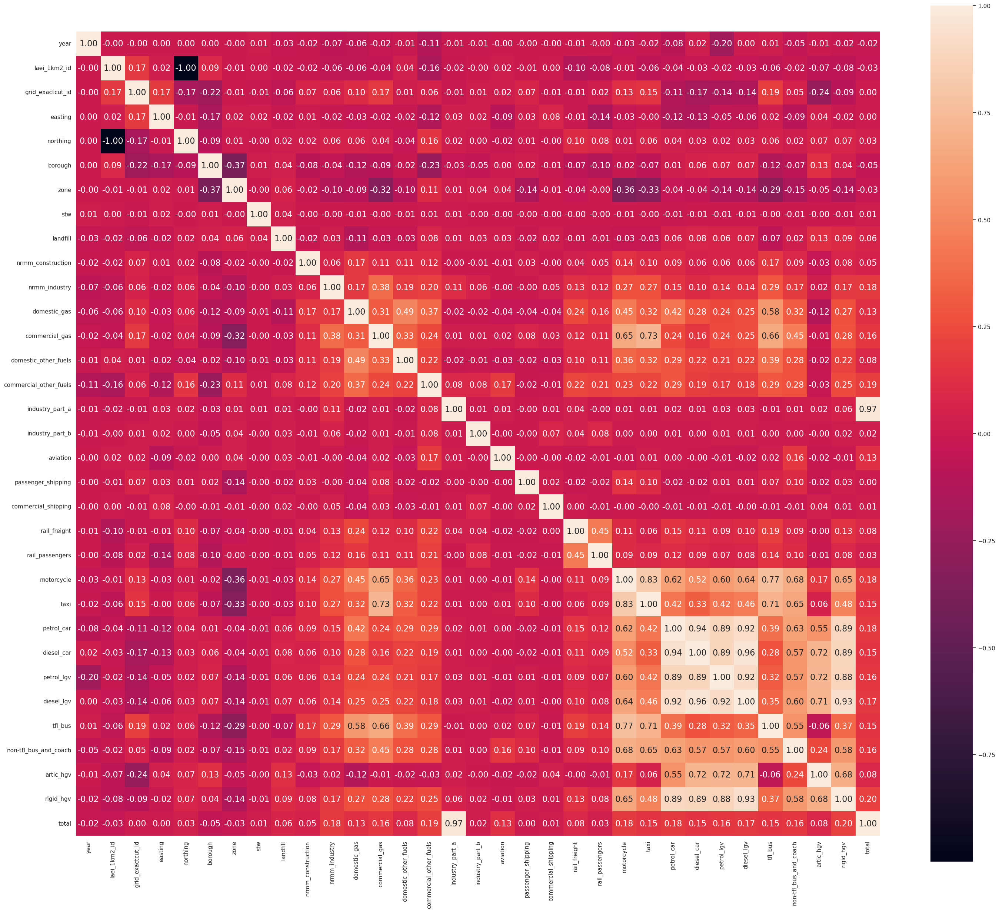

In [21]:
corr = clean_data.corr()
plt.figure(figsize=(35,30))
sns.set(font_scale=1)
sns.heatmap(corr,annot=True,annot_kws={"size":16},square=True,fmt=".2f",xticklabels="auto",yticklabels="auto")

### Analysis of each feature to see if there are any outliers
One way is to plot the columns referring to year and have a look into them.\
After we can use the describe method to see the mean, std,min and max values.\
If we see something that is to much outside we can decide to remove it.

In [22]:
clean_data.columns

Index(['year', 'laei_1km2_id', 'grid_exactcut_id', 'easting', 'northing', 'borough', 'zone', 'stw', 'landfill', 'nrmm_construction', 'nrmm_industry', 'domestic_gas', 'commercial_gas', 'domestic_other_fuels', 'commercial_other_fuels', 'industry_part_a', 'industry_part_b', 'aviation', 'passenger_shipping', 'commercial_shipping', 'rail_freight', 'rail_passengers', 'motorcycle', 'taxi', 'petrol_car', 'diesel_car', 'petrol_lgv', 'diesel_lgv', 'tfl_bus', 'non-tfl_bus_and_coach', 'artic_hgv', 'rigid_hgv', 'total'], dtype='object')

In [23]:
clean_data.describe()

,year,laei_1km2_id,grid_exactcut_id,easting,northing,borough,zone,stw,landfill,nrmm_construction,nrmm_industry,domestic_gas,commercial_gas,domestic_other_fuels,commercial_other_fuels,industry_part_a,industry_part_b,aviation,passenger_shipping,commercial_shipping,rail_freight,rail_passengers,motorcycle,taxi,petrol_car,diesel_car,petrol_lgv,diesel_lgv,tfl_bus,non-tfl_bus_and_coach,artic_hgv,rigid_hgv,total
count,10065.000000,10065.000000,10065.00000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,1.006500e+04,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,10065.000000,1.006500e+04
mean,2010.333333,10171.481073,1678.00000,529707.451565,178835.618480,18.245007,2.334724,3.278689,451.370537,155.662852,25.381856,2803.930345,1288.443377,38.520304,232.102541,1.241881e+03,13.276265,325.421913,4.421413,14.686286,8.848786,18.417144,27.085423,88.771115,1221.812167,619.025774,12.679002,320.486980,200.665253,75.571282,239.977160,253.952233,9.685670e+03
std,2.054907,2159.635452,968.55315,14687.418914,12554.912298,9.585621,0.802626,328.932700,1941.205919,767.647551,74.451785,3284.182442,3255.179047,53.294159,270.186630,3.671916e+04,284.870940,4470.902888,55.169503,265.811742,32.556183,91.770663,45.568241,254.387052,1322.655517,741.465303,18.084550,416.290235,403.554215,132.267173,690.035779,340.757549,3.804064e+04
min,2008.000000,5910.000000,1.00000,501500.000000,152500.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.620224e-02
25%,2008.000000,8487.000000,839.00000,517500.000000,169500.000000,10.000000,2.000000,0.000000,0.000000,0.000000,0.497110,180.568299,151.093150,4.594647,66.089617,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.552507,3.495664,170.011039,80.750038,1.229999,33.435708,2.183276,4.552595,4.866265,24.012827,1.766579e+03
50%,2010.000000,10059.000000,1678.00000,529500.000000,179500.000000,21.000000,3.000000,0.000000,0.000000,0.000000,4.094587,1456.802732,443.715808,21.673140,148.482297,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.519070,19.832316,823.859720,388.707783,5.957997,171.090934,42.291716,31.772393,33.103148,124.804249,6.328637e+03
75%,2013.000000,11797.000000,2517.00000,541500.000000,188500.000000,26.000000,3.000000,0.000000,0.000000,58.241496,19.567059,4632.997222,1149.496578,49.689421,273.337933,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,32.424050,58.053303,1802.870185,849.202877,15.647006,413.141736,221.975282,95.082393,110.468237,322.762480,1.241446e+04
max,2013.000000,14708.000000,3355.00000,561500.000000,203500.000000,33.000000,3.000000,33000.000000,31761.487299,23051.797402,1768.834170,20279.097684,71356.147049,627.203333,1748.750255,2.300000e+06,14769.330000,136471.072451,1864.350969,13662.202126,369.468909,1083.979343,686.214041,4022.979519,9178.180132,5435.730558,136.721473,2619.127111,5238.205652,2064.881628,6070.520481,2594.459983,2.312328e+06


In [24]:
clean_data.stw.unique()

array([    0., 33000.])

In [25]:
clean_data  = clean_data.drop(columns=['stw']).copy()

# Detecting outliers with z score method

In [26]:
outliers = []
def detect_outliers(data,std_dev_thr):
    threshold = int(std_dev_thr)
    mean = np.mean(data)
    std = np.std(data)

    for i in data:
        z_score= (i-mean)/std
        if np.abs(z_score)> threshold:
            outliers.append(i)
    return outliers

In [27]:
evaluate_columns = [ 'landfill', 'nrmm_construction', 'nrmm_industry', 'domestic_gas', 'commercial_gas', 'domestic_other_fuels', 
                'commercial_other_fuels', 'industry_part_a', 'industry_part_b', 'aviation', 'passenger_shipping', 'commercial_shipping', 
                'rail_freight', 'rail_passengers', 'motorcycle', 'taxi', 'petrol_car', 'diesel_car', 'petrol_lgv', 'diesel_lgv',
                'tfl_bus', 'non-tfl_bus_and_coach', 'artic_hgv', 'rigid_hgv', 'total']

In [28]:
for clm in evaluate_columns:
    outliers = []
    outliers = detect_outliers(clean_data[clm].tolist(),5)
    print("Column: " + clm )
    print(outliers)
    print("\n")

Column: landfill
[16816.7073250218, 14164.484874265703, 12884.839359372125, 10349.906783108838, 12490.86540470977, 12491.301726981765, 15969.648342496459, 11857.558209096522, 14889.50899979961, 14228.866153531075, 25607.876760099734, 12755.942993594694, 10757.04236839556, 21934.05450576324, 24372.459378723364, 17142.604779776935, 13249.081100006555, 13356.784398899652, 18988.23994518124, 26356.202545685654, 12257.713867658915, 11536.744095398359, 12125.107295680556, 10452.948872165489, 12501.90689, 19107.22023607844, 12710.075315215534, 31369.21707492323, 15138.420535319667, 11724.739527055332, 11474.078964900234, 12886.396421330764, 23265.03454004149, 28026.00274122945, 15130.751056479228, 14905.256146610498, 31761.487299209493, 11610.900377046477, 19065.363694090876, 14915.705593211125, 15762.78215389348, 12285.02677769504, 11114.724846139407, 13713.750112637897, 11550.906029626416, 10507.376015499527, 10186.09669279739, 10186.452505612115, 13022.987348925024, 12142.15135897749, 1160

## Divide the data for each year
Using the Z_score method we are getting too many values as outliers, we can approach the problem in a simpler way.\
we can divide the data set for each year and try to figure out outliers in each data set by plotting them


In [29]:
clean_data.year.unique()

array([2008, 2010, 2013])

In [30]:
y_2008 = clean_data.loc[clean_data.year == 2008]
y_2010 = clean_data.loc[clean_data.year == 2010]
y_2013 = clean_data.loc[clean_data.year == 2013]

In [31]:
def plot_clm(df1,df2,df3,column_name):
    fig1 = px.scatter(df1, x=df1.index, y=column_name, title=f'Plot of {column_name} in DataFrame 2008')
    fig1.show()

    # Plot for DataFrame 2
    fig2 = px.scatter(df2, x=df2.index, y=column_name, title=f'Plot of {column_name} in DataFrame 2010')
    fig2.show()

    # Plot for DataFrame 3
    fig3 = px.scatter(df3, x=df3.index, y=column_name, title=f'Plot of {column_name} in DataFrame 2013')
    fig3.show()

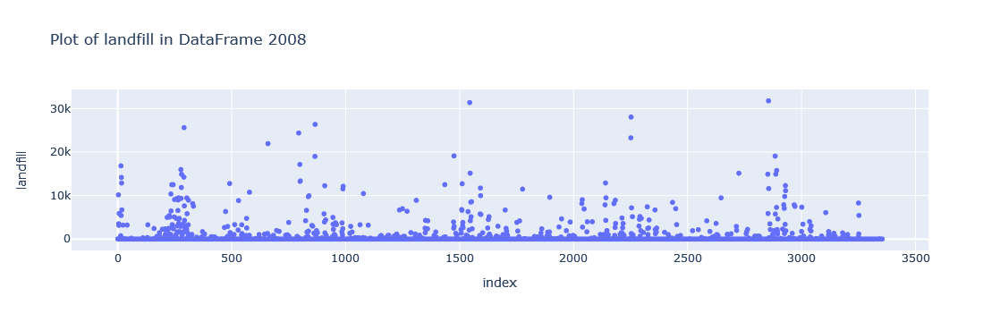

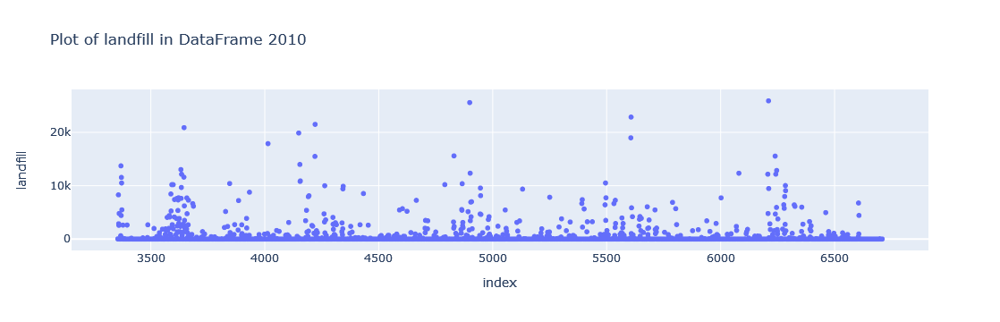

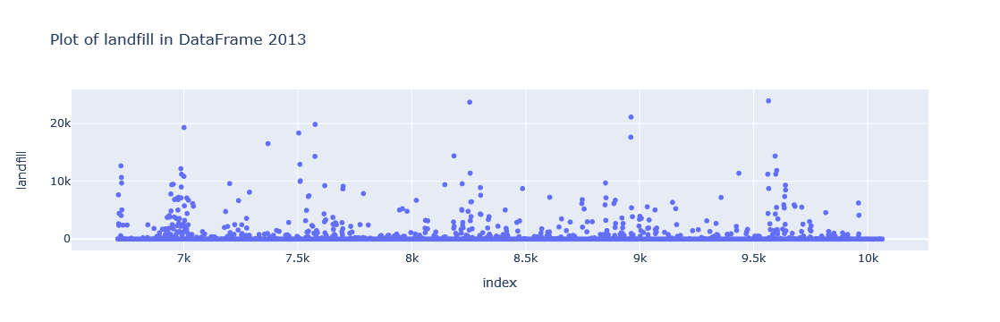

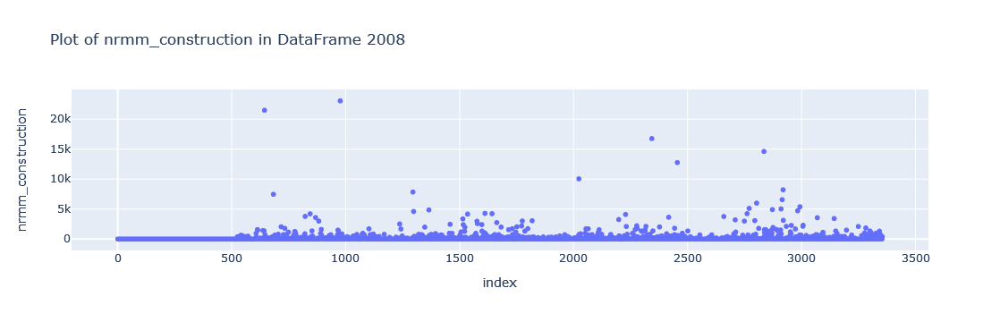

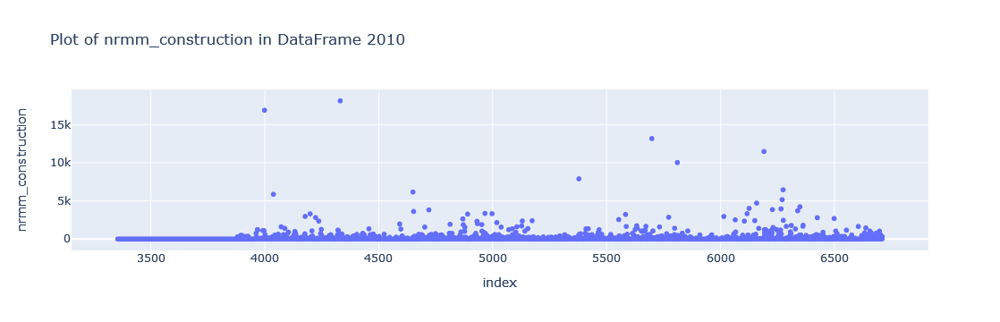

...

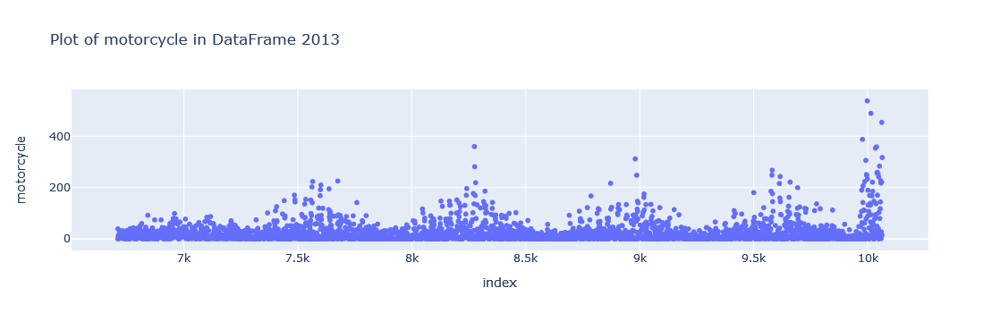

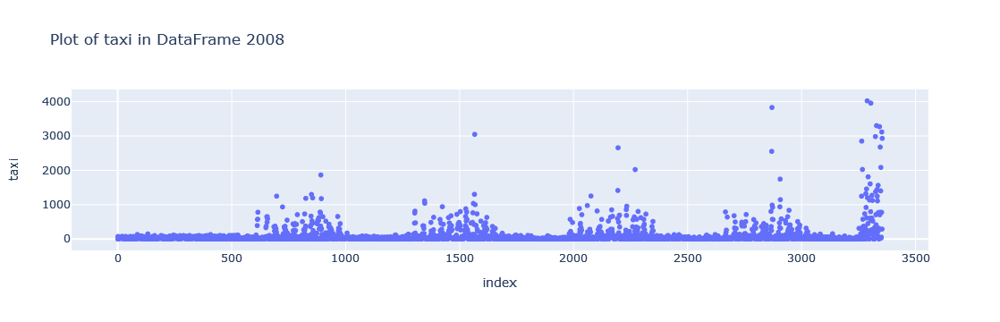

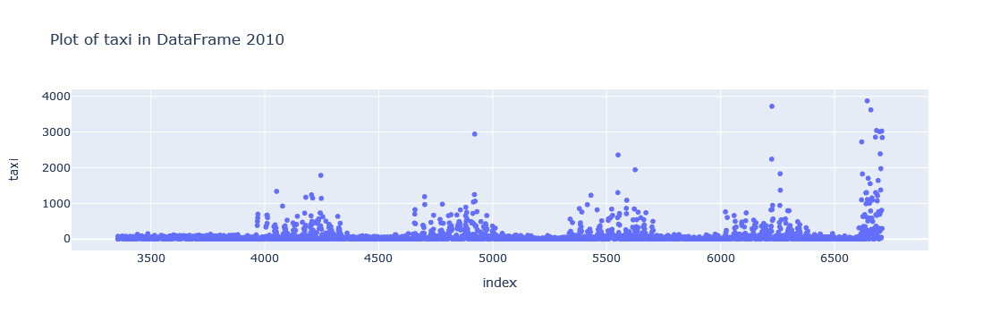

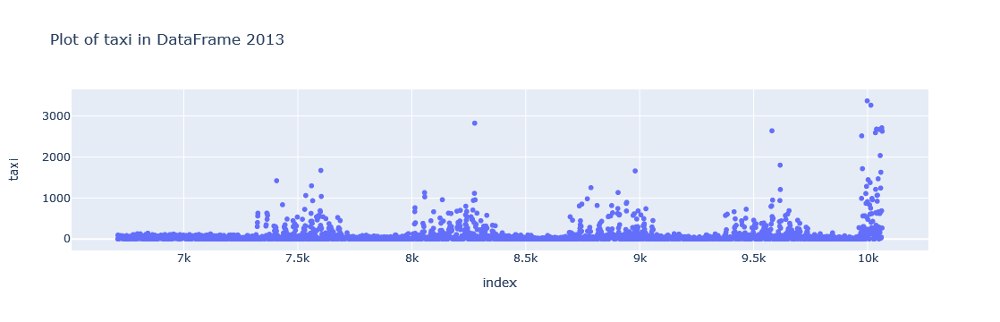

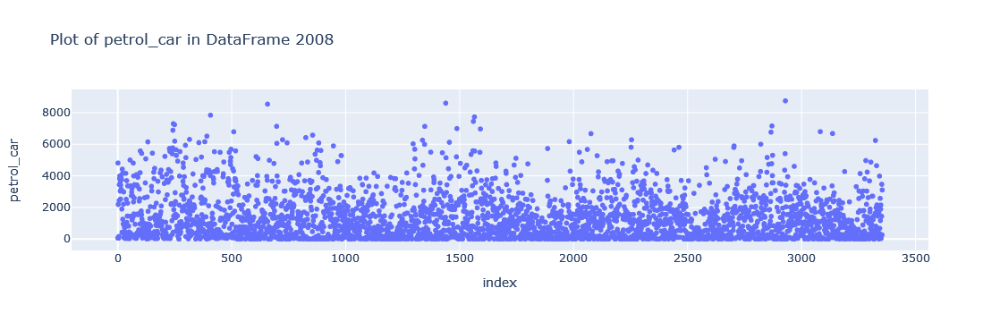

In [32]:

for clm in evaluate_columns:
    plot_clm(y_2008,y_2010,y_2013,clm)

# Looking at the plots:
looking into each plt for every year we can decide what is the maximum value to keep.\
We can remove the rows that cointan values higher than a threshold.\
The threshold can be the minimum of the maximum values in the plots.\
***we will not delete any row because the values are referred also by zones, it could be that some pollutants are more concentrated in just some specifi zones***\
***this is just for educational purpose***.

In [33]:
counts = []

***landfill:*** maximum value should be 20k.

In [34]:
count = clean_data[clean_data.landfill >= 20000]
counts.append(count.shape[0])
counts

[16]

***nrmm_construction:*** max value should be 10k

In [35]:
count = clean_data[clean_data.nrmm_construction >= 10000]
counts.append(count.shape[0])
counts

[16, 15]

***nrmm_industry:*** max value should be 1k

In [36]:
count = clean_data[clean_data.nrmm_industry >= 1000]
counts.append(count.shape[0])
counts

[16, 15, 11]

***commercial_gas:*** max value should be 40k

In [37]:
count = clean_data[clean_data.commercial_gas >= 40000]
counts.append(count.shape[0])
counts

[16, 15, 11, 8]

***domestic_other_fuels:*** max value should be 400

In [38]:
count = clean_data[clean_data.domestic_other_fuels >= 400]
counts.append(count.shape[0])
counts

[16, 15, 11, 8, 20]

In [39]:
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10065 entries, 0 to 10064
Data columns (total 32 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   year                    10065 non-null  int64  
 1   laei_1km2_id            10065 non-null  int64  
 2   grid_exactcut_id        10065 non-null  int64  
 3   easting                 10065 non-null  int64  
 4   northing                10065 non-null  int64  
 5   borough                 10065 non-null  int64  
 6   zone                    10065 non-null  int64  
 7   landfill                10065 non-null  float64
 8   nrmm_construction       10065 non-null  float64
 9   nrmm_industry           10065 non-null  float64
 10  domestic_gas            10065 non-null  float64
 11  commercial_gas          10065 non-null  float64
 12  domestic_other_fuels    10065 non-null  float64
 13  commercial_other_fuels  10065 non-null  float64
 14  industry_part_a         10065 non-null

# remove columns referring to grids 

columns: ***laei_1km2_id***, ***grid_exactcut_id***, ***easting***, ***northing*** can be removed because we will only use the zone and boroughs

In [40]:
clean_data  = clean_data.drop(columns=['laei_1km2_id','grid_exactcut_id','easting','northing']).copy()

In [41]:
clean_data.head()

,year,borough,zone,landfill,nrmm_construction,nrmm_industry,domestic_gas,commercial_gas,domestic_other_fuels,commercial_other_fuels,industry_part_a,industry_part_b,aviation,passenger_shipping,commercial_shipping,rail_freight,rail_passengers,motorcycle,taxi,petrol_car,diesel_car,petrol_lgv,diesel_lgv,tfl_bus,non-tfl_bus_and_coach,artic_hgv,rigid_hgv,total
0,2008,26,2,40.299208,0.0,29.037647,169.896525,267.599694,34.661398,225.726463,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.794446,0.729308,65.296798,28.201613,0.530240,11.047829,0.976673,3.437355,1.056543,6.777960,886.069700
1,2008,26,2,0.000000,0.0,16.445759,91.442445,311.594175,20.145096,276.459214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46.059539,75.319727,4813.802423,2779.411657,82.955116,1515.757059,30.338328,193.357560,2591.992620,1153.954988,13999.035705
2,2008,26,2,0.000000,0.0,77.735009,253.379851,311.591604,19.937190,276.456934,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19.434101,34.094676,2188.666090,1398.219593,44.999390,721.108900,5.993533,79.087914,1899.210830,620.269635,7950.185250
3,2008,26,2,10152.007346,0.0,19.704125,980.361642,320.748184,6.243711,276.459214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.792363,0.727326,65.081353,28.108563,0.528477,11.011090,0.973637,3.426670,1.049198,6.755514,11873.978414
4,2008,26,2,3513.850389,0.0,1.028658,1122.054950,505.360236,9.088597,276.456934,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.714850,0.656304,58.761915,25.379204,0.477185,9.942397,0.878163,3.090653,0.948943,6.099634,5534.789011


<Axes: >

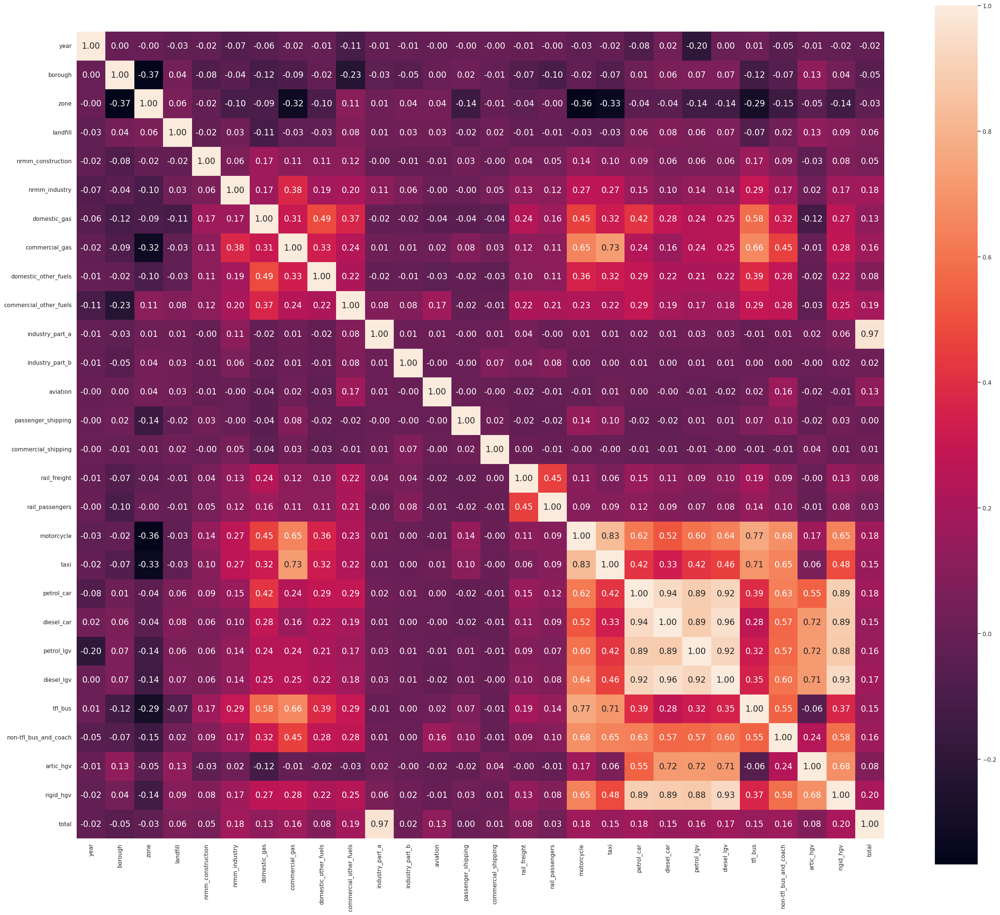

In [42]:
corr = clean_data.corr()
plt.figure(figsize=(35,30))
sns.set(font_scale=1)
sns.heatmap(corr,annot=True,annot_kws={"size":16},square=True,fmt=".2f",xticklabels="auto",yticklabels="auto")

# Saving file with clean data

In [43]:
file_name = 'LAEI2013_Emissions_Summary-CO2_v1.1_Clean.xlsx'
clean_data.to_excel(file_name,sheet_name='IN',index=False)

In [6]:
# REVIEW OF DATA ANALYSIS AND CLEANING PROCESS
# Upon loading the data file appeare to be with no missing dtaa in each columns. 
# Some columns has zero weight in the data set, some had categorical data and one in particular had numerical values written as strings.
# conversion of the text values in numerical form is performed. 
# OneHot(OH) encoding has been avoided, because it would have increased the data complexity of the set,
# after dropping the zero weighted columns the data set has 32 columns, using OH encoding e.g. on the "Zone" columns would have added 
# other 34 columns in the set. The main disadvantages of OH encoding are the high dimensionality, multicollinearity,  
# loss of ordinal relationships, difficulty in interpreting results, and increased memory and storage requirements. 
# To avoid these kind of disadvantages labelEncoding has been used in order to reduce the above mentioned 'problems',
# another advantage of using LabelEncoding is faster model training. 
# The models used for this assignement will be Random FOrest Regression, XGBoost and SVM. 
# Random Forest and XGBoost models can handle feature space, either OH encoding or LabelEncoding could have been used. 
# SVM in the opposite is a model that is more sensitive to the number of features and high dimensionality, created by the OH ecnoding.
# So in summary LabelEncoding is the choosen apporach to encode the values, in order to have a consistent data set to be used for all models. 
# All rows referrign to years above 2013 have been dropped, we have kept years from 2013 and below, because it will give us data to use for regression.  
#
# DATA AFTER CLEANING:
# Lost almost half of the rows after removing the unwanted years.
# Using the Z_score method gave insight of outliers present in various features, multiple values for each feature. 
# Scatter plots have been made in order to better visualize value distribution, diving the data in three subsets, one for each year. 
# Being this a data set regarding emissions, perhaps these values that appears as ouliers could have been affected by factor that are not known to us,
# moreover some emission might be more concentrated in particular ares, causing some values to be more higher than others. 
# each value is referred to a different zone, so it could highly be possible that some areas have more concentration than others,
# or peaks in the values could have been caused by fires or other events, unknown to us. 
# so it has been decided to maintaint all the values in the dataset. 
# Data set has been saved in the numerical form ready to be used, for the training of the models, in the file a readme sheet has been added
# containing the mapping for the encoded values. 
